# Human Activity Recognition from Wearable Inertial Sensor Networks Part 5

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Table of Contents
- [Import library and define visualization parameters](#Import-library-and-define-visualization-parameters)
- [Declaration of functions used](#Declaration-of-functions-used)
- [Import data](#Import-data)
- [Train machine learning models](#Train-Machine-Learning-Models)


# Import library and define visualization parameters

In [ ]:
from __future__ import print_function
from matplotlib import pyplot as plt
from matplotlib.ticker import FuncFormatter
from matplotlib import cm
%matplotlib inline
import numpy as np
import pandas as pd
import seaborn as sns
from scipy import stats

import pickle
import sklearn
from sklearn import decomposition
from sklearn import preprocessing
from sklearn.feature_selection import RFECV, RFE
from sklearn.pipeline import make_pipeline, Pipeline
from sklearn.preprocessing import LabelEncoder
from sklearn import metrics
from sklearn.metrics import roc_curve, roc_auc_score, classification_report, accuracy_score, confusion_matrix, f1_score
from sklearn.model_selection import train_test_split, learning_curve, cross_val_predict, GridSearchCV, StratifiedKFold, GroupKFold
from sklearn.utils import shuffle
from sklearn.tree import export_graphviz
import graphviz
from sklearn.model_selection import cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, export_text
from sklearn.svm import SVC, LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier

import os
from subprocess import call

import warnings 
warnings.filterwarnings('ignore')

# Display several outputs on a notebook output
from IPython.display import Image  
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

In [ ]:
# Define certain standard parameters at the outset
pd.options.display.float_format = '{: .4f}'. format
np.set_printoptions(precision=4)
plt.style.use ('ggplot')
# Files
path_to_file = '/content/drive/MyDrive/myproject/outputdata'

# Declaration of functions used

In [ ]:
def plot_confusion_matrix(cm, classes, normalize=True, title='Confusion matrix', cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    import itertools
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix without normalization')

    plt.figure(figsize=(26,9))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

# Import data

In [ ]:
!cp /content/drive/MyDrive/myproject/outputdata/df_4.pkl /tmp/df_4.pkl
!cp /content/drive/MyDrive/myproject/outputdata/X.pkl /tmp/X.pkl

In [ ]:
df = pd.read_pickle('/tmp/df_4.pkl')
X = pd.read_pickle('/tmp/X.pkl')

# Train machine learning models 

## Set scaler for pipeline

In [ ]:
sc = preprocessing.StandardScaler()

## Label Encoder

In [ ]:
activity = df['activity']
le = LabelEncoder().fit(activity)
y = le.transform(activity)
y

array([0, 0, 0, ..., 4, 4, 4])

In [ ]:
set(y)

{0, 1, 2, 3, 4}

In [ ]:
y_lab = le.inverse_transform(y)
set(y_lab)

{'Bicycling', 'Running', 'Sitting', 'Standing', 'Walking'}

In [ ]:
labels = ['Bicycling', 'Running', 'Sitting', 'Standing', 'Walking']

## Logistic Regression Classifier

In [ ]:
sklearn.metrics.SCORERS.keys()

dict_keys(['explained_variance', 'r2', 'max_error', 'neg_median_absolute_error', 'neg_mean_absolute_error', 'neg_mean_squared_error', 'neg_mean_squared_log_error', 'neg_root_mean_squared_error', 'neg_mean_poisson_deviance', 'neg_mean_gamma_deviance', 'accuracy', 'roc_auc', 'roc_auc_ovr', 'roc_auc_ovo', 'roc_auc_ovr_weighted', 'roc_auc_ovo_weighted', 'balanced_accuracy', 'average_precision', 'neg_log_loss', 'neg_brier_score', 'adjusted_rand_score', 'homogeneity_score', 'completeness_score', 'v_measure_score', 'mutual_info_score', 'adjusted_mutual_info_score', 'normalized_mutual_info_score', 'fowlkes_mallows_score', 'precision', 'precision_macro', 'precision_micro', 'precision_samples', 'precision_weighted', 'recall', 'recall_macro', 'recall_micro', 'recall_samples', 'recall_weighted', 'f1', 'f1_macro', 'f1_micro', 'f1_samples', 'f1_weighted', 'jaccard', 'jaccard_macro', 'jaccard_micro', 'jaccard_samples', 'jaccard_weighted'])

### Logistic regression with elasticnet gridsearch cv 

In [ ]:
LR_model_grid = LogisticRegression(multi_class='multinomial', class_weight='balanced', random_state=1, n_jobs=-1)

In [ ]:
LR_model_grid_pipeline = make_pipeline(sc, LR_model_grid)
LR_model_grid_pipeline

Pipeline(memory=None,
         steps=[('standardscaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('logisticregression',
                 LogisticRegression(C=1.0, class_weight='balanced', dual=False,
                                    fit_intercept=True, intercept_scaling=1,
                                    l1_ratio=None, max_iter=100,
                                    multi_class='multinomial', n_jobs=-1,
                                    penalty='l2', random_state=1,
                                    solver='lbfgs', tol=0.0001, verbose=0,
                                    warm_start=False))],
         verbose=False)

In [ ]:
penalty = ['l1', 'elasticnet']
C = [0.001, 0.01, 0.1, 1.0, 10.0, 100.0, 1000.0]
solver = ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
l1_ratio = [0.95, 0.955, 0.9556, 0.957, 0.96, 0.97, 0.98, 0.99, 0.999, 0.998, 1]

In [ ]:
param_grid = dict(logisticregression__penalty=penalty, logisticregression__C=C, logisticregression__solver=solver, logisticregression__l1_ratio=l1_ratio)

In [ ]:
LR_grid = GridSearchCV(estimator = LR_model_grid_pipeline, param_grid = param_grid , cv=StratifiedKFold(5, shuffle=True, random_state=1), scoring = 'f1_weighted', verbose = 1, n_jobs = -1)

In [ ]:
LR_grid_fit = LR_grid.fit(X,y)

Fitting 5 folds for each of 770 candidates, totalling 3850 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done 120 tasks      | elapsed:    6.1s
[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:  2.8min
[Parallel(n_jobs=-1)]: Done 720 tasks      | elapsed:  4.4min
[Parallel(n_jobs=-1)]: Done 1170 tasks      | elapsed:  8.5min
[Parallel(n_jobs=-1)]: Done 1720 tasks      | elapsed: 12.2min
[Parallel(n_jobs=-1)]: Done 2370 tasks      | elapsed: 18.6min
[Parallel(n_jobs=-1)]: Done 3120 tasks      | elapsed: 23.9min
[Parallel(n_jobs=-1)]: Done 3850 out of 3850 | elapsed: 30.8min finished


In [ ]:
print("Best parameter (CV score=%0.3f):" % LR_grid_fit.best_score_)
print(LR_grid_fit.best_params_)

Best parameter (CV score=0.900):
{'logisticregression__C': 100.0, 'logisticregression__l1_ratio': 0.95, 'logisticregression__penalty': 'l1', 'logisticregression__solver': 'saga'}


### Logistic Regression Classifier with best params from elasticnet gridsearchCV

In [ ]:
LR_model_elas = LogisticRegression(multi_class='multinomial', class_weight='balanced', solver='saga', penalty='l1', l1_ratio=0.95, C=100, random_state=1, n_jobs=-1)

In [ ]:
LR_model_elas_pipeline = make_pipeline(sc, LR_model_elas)

In [ ]:
y_pred_LR_elas = cross_val_predict(LR_model_elas_pipeline, X, y, cv=StratifiedKFold(5, shuffle=True, random_state=1), n_jobs = -1, verbose=1)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   51.6s finished


In [ ]:
LR_model_elas_fit = LR_model_elas_pipeline.fit(X,y)

In [ ]:
y_pred_LR_elas = le.inverse_transform(y_pred_LR_elas)

In [ ]:
LR_score = accuracy_score(y_lab, y_pred_LR_elas)

### Feature selection by importances from lasso gridsearchCV

In [ ]:
LR_feature_importances = abs(LR_model_elas_fit.named_steps.logisticregression.coef_[0])
LR_feature_importances = 100.0 * (LR_feature_importances / sum(LR_feature_importances))
LR_feature_importances = pd.DataFrame({'feature': list(X.columns), 'importance': LR_feature_importances}).sort_values('importance', ascending = False)
LR_feature_importances

,feature,importance
111,colat_gyro_amax,0.6149
182,acc_rf_z_median_lag1,0.5910
183,acc_rf_z_median_lag2,0.5816
25,acc_rf_z_median,0.5768
530,acc_rf_x_amax_lag1_logabs,0.5419
...,...,...
788,long_gyro_mad_lag1_logabs,0.0015
449,gyro_rf_y_mad_logabs,0.0014
558,acc_rf_y_std_lag1_logabs,0.0013
469,acc_norm_iqr_logabs,0.0003


In [ ]:
# Find the features with zero importance
LR_zero_features = list(LR_feature_importances[LR_feature_importances['importance'] == 0.0]['feature'])
print('There are %d features with 0.0 importance' % len(LR_zero_features))
LR_feature_importances.tail()

There are 0 features with 0.0 importance


,feature,importance
788,long_gyro_mad_lag1_logabs,0.0015
449,gyro_rf_y_mad_logabs,0.0014
558,acc_rf_y_std_lag1_logabs,0.0013
469,acc_norm_iqr_logabs,0.0003
474,colat_acc_amax_logabs,0.0001


In [ ]:
# Let's remove the features that have zero importance
X_LR_features = X.drop(columns = LR_zero_features)
X_LR_features

,acc_rf_x_amin,acc_rf_x_amax,acc_rf_x_mean,acc_rf_x_median,acc_rf_x_std,acc_rf_x_skew,acc_rf_x_kurtosis,acc_rf_x_iqr,acc_rf_x_median_absolute_deviation,acc_rf_x_mad,acc_rf_x_ran,acc_rf_y_amin,acc_rf_y_amax,acc_rf_y_mean,acc_rf_y_median,acc_rf_y_std,acc_rf_y_skew,acc_rf_y_kurtosis,acc_rf_y_iqr,acc_rf_y_median_absolute_deviation,acc_rf_y_mad,acc_rf_y_ran,acc_rf_z_amin,acc_rf_z_amax,acc_rf_z_mean,acc_rf_z_median,acc_rf_z_std,acc_rf_z_skew,acc_rf_z_kurtosis,acc_rf_z_iqr,acc_rf_z_median_absolute_deviation,acc_rf_z_mad,acc_rf_z_ran,gyro_rf_x_amin,gyro_rf_x_amax,gyro_rf_x_mean,gyro_rf_x_median,gyro_rf_x_std,gyro_rf_x_skew,gyro_rf_x_kurtosis,...,colat_gyro_mean_lag1_logabs,colat_gyro_mean_lag2_logabs,colat_gyro_median_lag1_logabs,colat_gyro_median_lag2_logabs,colat_gyro_std_lag1_logabs,colat_gyro_std_lag2_logabs,colat_gyro_skew_lag1_logabs,colat_gyro_skew_lag2_logabs,colat_gyro_kurtosis_lag1_logabs,colat_gyro_kurtosis_lag2_logabs,colat_gyro_iqr_lag1_logabs,colat_gyro_iqr_lag2_logabs,colat_gyro_median_absolute_deviation_lag1_logabs,colat_gyro_median_absolute_deviation_lag2_logabs,colat_gyro_mad_lag1_logabs,colat_gyro_mad_lag2_logabs,colat_gyro_ran_lag1_logabs,colat_gyro_ran_lag2_logabs,long_gyro_amin_lag1_logabs,long_gyro_amin_lag2_logabs,long_gyro_amax_lag1_logabs,long_gyro_amax_lag2_logabs,long_gyro_mean_lag1_logabs,long_gyro_mean_lag2_logabs,long_gyro_median_lag1_logabs,long_gyro_median_lag2_logabs,long_gyro_std_lag1_logabs,long_gyro_std_lag2_logabs,long_gyro_skew_lag1_logabs,long_gyro_skew_lag2_logabs,long_gyro_kurtosis_lag1_logabs,long_gyro_kurtosis_lag2_logabs,long_gyro_iqr_lag1_logabs,long_gyro_iqr_lag2_logabs,long_gyro_median_absolute_deviation_lag1_logabs,long_gyro_median_absolute_deviation_lag2_logabs,long_gyro_mad_lag1_logabs,long_gyro_mad_lag2_logabs,long_gyro_ran_lag1_logabs,long_gyro_ran_lag2_logabs
0,-26828.0000,228.0000,-14573.2955,-15614.0000,5793.7028,0.1629,-0.8552,9196.0000,6473.0316,4944.5560,27056.0000,-5964.0000,8844.0000,1925.3182,1846.0000,2520.9770,-0.1507,0.2721,3458.0000,2748.7404,1996.3631,14808.0000,-716.0000,17512.0000,6885.6818,6854.0000,3032.2412,0.4930,0.7177,3854.0000,2873.2788,2349.0573,18228.0000,-7436.0000,7932.0000,-573.8693,-512.5000,4063.0418,0.1185,-1.1772,...,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
1,-32768.0000,2744.0000,-15908.3182,-17936.0000,8476.0718,0.2310,-1.0835,13653.0000,10247.7312,7440.2546,35512.0000,-7160.0000,11156.0000,1906.0909,2280.0000,3006.8416,-0.2840,0.3281,3892.0000,2653.8540,2344.5134,18316.0000,-2660.0000,16468.0000,6917.0682,7444.0000,4221.9786,-0.3141,-0.6804,5915.0000,4581.2340,3497.1772,19128.0000,-8612.0000,6710.0000,-724.3693,-1421.5000,4409.9493,0.1142,-1.3357,...,0.9463,0.0000,1.0003,0.0000,0.3244,0.0000,0.0088,0.0000,0.8070,0.0000,0.5184,0.0000,0.4062,0.0000,0.3001,0.0000,0.9794,0.0000,1.3326,0.0000,1.3926,0.0000,0.1496,0.0000,0.6560,0.0000,1.0010,0.0000,0.1314,0.0000,1.0215,0.0000,1.4551,0.0000,0.8251,0.0000,0.9825,0.0000,1.9193,0.0000
2,-30940.0000,1836.0000,-16694.3182,-18150.0000,8272.1209,0.4232,-0.8617,13774.0000,9230.6676,7004.7557,32776.0000,-6472.0000,8020.0000,1933.4773,2478.0000,2786.0552,-0.3112,-0.3191,3741.0000,2745.7752,2283.8549,14492.0000,-3380.0000,14924.0000,6404.4545,7276.0000,3980.7550,-0.4040,-0.7550,6252.0000,4237.2708,3361.0393,18304.0000,-8296.0000,6519.0000,333.5682,678.5000,3950.7688,-0.2755,-1.0499,...,0.9552,0.9463,1.0365,1.0003,0.3581,0.3244,0.1592,0.0088,0.8958,0.8070,0.5690,0.5184,0.4490,0.4062,0.3397,0.3001,1.0238,0.9794,1.3137,1.3326,1.2723,1.3926,0.3722,0.1496,1.0031,0.6560,0.9784,1.0010,0.1504,0.1314,1.0422,1.0215,1.4419,1.4551,0.7283,0.8251,0.9619,0.9825,1.8388,1.9193
3,-27988.0000,100.0000,-14594.7045,-15108.0000,7188.4512,0.0694,-1.1602,12289.0000,9310.7280,6313.0522,28088.0000,-4552.000

### LR Confusion matrix

In [ ]:
print(classification_report(y_lab, y_pred_LR_elas))

              precision    recall  f1-score   support

   Bicycling       0.97      0.97      0.97       908
     Running       0.84      0.95      0.89       493
     Sitting       0.77      0.83      0.80      3228
    Standing       0.85      0.80      0.82      4217
     Walking       0.99      0.97      0.98      7158

    accuracy                           0.90     16004
   macro avg       0.88      0.91      0.89     16004
weighted avg       0.90      0.90      0.90     16004



Normalized confusion matrix


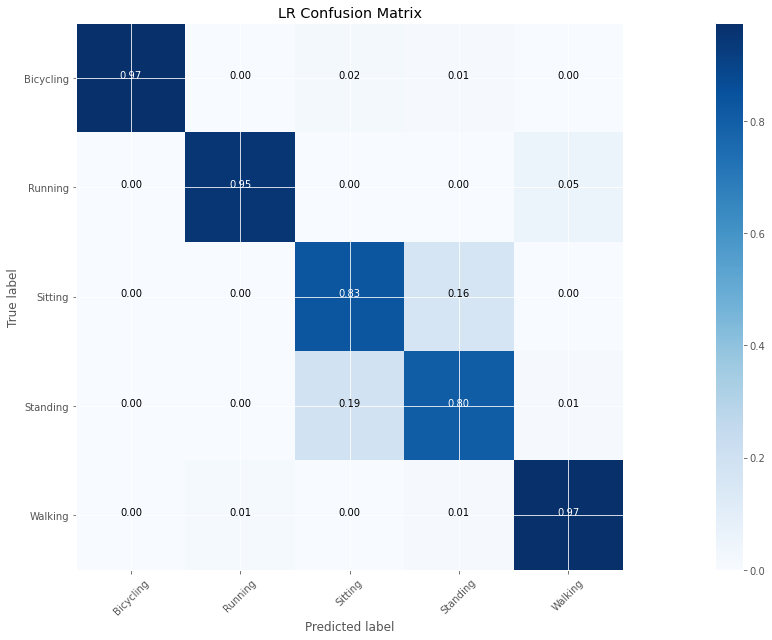

In [ ]:
cm = confusion_matrix(y_lab, y_pred_LR_elas)
plot_confusion_matrix(cm, classes=labels, title='LR Confusion Matrix')

### LR Feature importance

In [ ]:
feature_importance = abs(LR_model_elas_fit.named_steps.logisticregression.coef_[0])
feature_importance = 100.0 * (feature_importance / sum(feature_importance))
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
featfig = plt.figure(figsize=(26,900))
featax = featfig.add_subplot(1, 1, 1)
featax.barh(pos, feature_importance[sorted_idx], align='center')
featax.set_yticks(pos)
featax.set_yticklabels(np.array(X.columns)[sorted_idx], fontsize=15)
plt.title('LR Most Important Features')
plt.tight_layout()   
plt.show();

### LR Learning curve

In [ ]:
# Create CV training and test scores for various training set sizes
train_sizes, train_scores, test_scores = learning_curve(LR_model_elas_fit.named_steps.logisticregression, 
                                                        X, 
                                                        y,
                                                        # Number of folds in cross-validation
                                                        cv=StratifiedKFold(5, shuffle=True, random_state=1),
                                                        # Evaluation metric
                                                        scoring='f1_weighted',
                                                        # Use all computer cores
                                                        n_jobs=-1,
                                                        random_state=1,
                                                        shuffle=True)

In [ ]:
# Create means and standard deviations of training set scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)

# Create means and standard deviations of test set scores
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

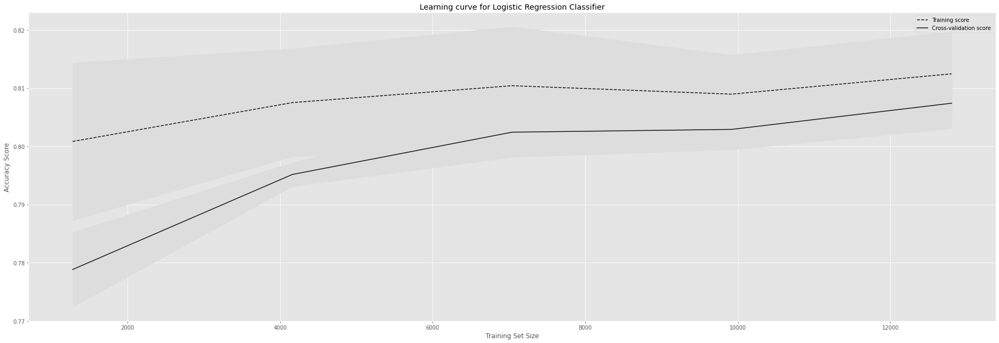

In [ ]:
# Draw lines
plt.figure(figsize=(26,9))
plt.plot(train_sizes, train_mean, '--', color="#111111",  label="Training score")
plt.plot(train_sizes, test_mean, color="#111111", label="Cross-validation score")

# Draw bands
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color="#DDDDDD")
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color="#DDDDDD")

# Create plot
plt.title("Learning curve for Logistic Regression Classifier")
plt.xlabel("Training Set Size"), plt.ylabel("Accuracy Score"), plt.legend(loc="best")
plt.tight_layout()
plt.show();

## Decision Tree Classifier

### Decision Tree Classifier with gridsearchCV

In [ ]:
DT_model = DecisionTreeClassifier(class_weight='balanced', random_state=1)

In [ ]:
DT_model_pipeline = make_pipeline(sc, DT_model)

In [ ]:
criterion = ['gini','entropy']
max_depth = np.arange(1,5)
splitter = ['best','random']
max_features = ['sqrt','log2']

In [ ]:
param_grid = [{'decisiontreeclassifier__criterion':criterion,
              'decisiontreeclassifier__max_depth':max_depth,
              'decisiontreeclassifier__splitter':splitter,
              'decisiontreeclassifier__max_features':max_features}]

In [ ]:
DT_grid = GridSearchCV(estimator = DT_model_pipeline, param_grid = param_grid , 
                       cv=StratifiedKFold(5, shuffle=True, random_state=1), 
                       scoring = 'f1_weighted', verbose = 1, n_jobs = -1)

In [ ]:
DT_grid_fit = DT_grid.fit(X,y)

Fitting 5 folds for each of 32 candidates, totalling 160 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done 160 out of 160 | elapsed:    5.9s finished


In [ ]:
print("Best parameter (CV score=%0.3f):" % DT_grid_fit.best_score_)
print(DT_grid_fit.best_params_)

Best parameter (CV score=0.816):
{'decisiontreeclassifier__criterion': 'gini', 'decisiontreeclassifier__max_depth': 4, 'decisiontreeclassifier__max_features': 'sqrt', 'decisiontreeclassifier__splitter': 'best'}


### Decision Tree Classifier with best params from gridsearchCV

In [ ]:
DT_model_best = DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=4, max_features='sqrt', splitter='best', random_state=1)

In [ ]:
DT_model_best_pipeline = make_pipeline(sc, DT_model_best)

In [ ]:
y_pred_DT_best = cross_val_predict(DT_model_best_pipeline, X, y, cv=StratifiedKFold(5, shuffle=True, random_state=1), n_jobs = -1, verbose=1)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:    0.6s finished


In [ ]:
DT_model_best_fit = DT_model_best_pipeline.fit(X,y)

In [ ]:
y_pred_DT_best = le.inverse_transform(y_pred_DT_best)

### Feature selection by importances from Decision Tree gridsearchCV

In [ ]:
DT_feature_importances = DT_model_best_pipeline.named_steps.decisiontreeclassifier.feature_importances_
DT_feature_importances = pd.DataFrame({'feature': list(X.columns), 'importance': DT_feature_importances}).sort_values('importance', ascending = False)
DT_feature_importances

,feature,importance
20,acc_rf_y_mad,0.3328
448,gyro_rf_y_median_absolute_deviation_logabs,0.2635
2,acc_rf_x_mean,0.2218
123,long_gyro_mean,0.0347
411,acc_rf_y_std_logabs,0.0341
...,...,...
269,acc_norm_mean_lag2,0.0000
270,acc_norm_median_lag1,0.0000
271,acc_norm_median_lag2,0.0000
272,acc_norm_std_lag1,0.0000


In [ ]:
# Find the features with zero importance
DT_zero_features = list(DT_feature_importances[DT_feature_importances['importance'] == 0.0]['feature'])
print('There are %d features with 0.0 importance' % len(DT_zero_features))
DT_feature_importances.tail()

There are 778 features with 0.0 importance


,feature,importance
269,acc_norm_mean_lag2,0.0000
270,acc_norm_median_lag1,0.0000
271,acc_norm_median_lag2,0.0000
272,acc_norm_std_lag1,0.0000
791,long_gyro_ran_lag2_logabs,0.0000


In [ ]:
# Let's remove the features that have zero importance
X_DT_features = X.drop(columns = DT_zero_features)
X_DT_features

,acc_rf_x_mean,acc_rf_y_mad,gyro_rf_z_mean,long_acc_median,long_gyro_mean,gyro_norm_mad_lag2,acc_rf_x_kurtosis_logabs,acc_rf_y_std_logabs,acc_rf_y_median_absolute_deviation_logabs,gyro_rf_y_median_absolute_deviation_logabs,gyro_norm_median_absolute_deviation_logabs,gyro_rf_y_amax_lag1_logabs,gyro_norm_amax_lag2_logabs,gyro_norm_median_absolute_deviation_lag1_logabs
0,-14573.2955,1996.3631,-45.3125,2.9051,-0.1613,0.0000,0.6180,7.8328,7.9193,9.3769,8.7697,0.0000,0.0000,0.0000
1,-15908.3182,2344.5134,-214.0341,2.9083,-0.4510,0.0000,0.7340,8.0090,7.8841,9.7504,9.0874,9.6900,0.0000,8.7697
2,-16694.3182,2283.8549,540.1193,2.9240,-0.0474,4575.3236,0.6215,7.9327,7.9182,9.5145,8.9185,10.0093,10.0547,9.0874
3,-14594.7045,1963.5834,-386.6705,2.8923,-0.3201,5783.4449,0.7702,7.8102,7.7745,9.5908,8.8870,9.9953,10.1910,8.9185
4,-15933.9318,2017.5085,615.0682,2.9293,-0.0560,5196.0901,0.6068,7.8279,7.9182,9.3390,8.7394,9.6921,10.1417,8.8870
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15999,-11757.8409,6297.2916,1195.5682,-2.3879,0.7509,15969.7633,0.3223,9.0255,8.0448,10.5167,9.9603,10.3972,10.8547,9.8565
16000,-11258.6023,5834.6860,418.2557,-2.4190,0.8858,15947.8979,0.8686,9.0717,8.0448,10.1395,10.1764,10.3972,10.8474,9.9603
16001,-10676.3807,6617.6880,421.4602,-2.3077,0.7778,16157.6536,0.8151,9.0921,8.5083,10.1891,10.1702,10.3972,10.8655,10.1764
16002,-10995.9716,7449.6550,236.0227,-2.3169,0.8050,16580.8173,0.9927,9.2751,8.1681,10.3170,10.1462,10.3972,10.8889,10.1702


### DT Tree Visualization

In [ ]:
export_graphviz(DT_model_best_pipeline.named_steps.decisiontreeclassifier, out_file='tree.dot',
                            feature_names=X.columns.tolist(),
                            class_names=labels,
                            filled=True, rounded=True,
                            special_characters=True)

In [ ]:
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=950'])
Image(filename = 'tree.png')

0

### Prunning The Tree

In [ ]:
path = DT_model_best.cost_complexity_pruning_path(X, y)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

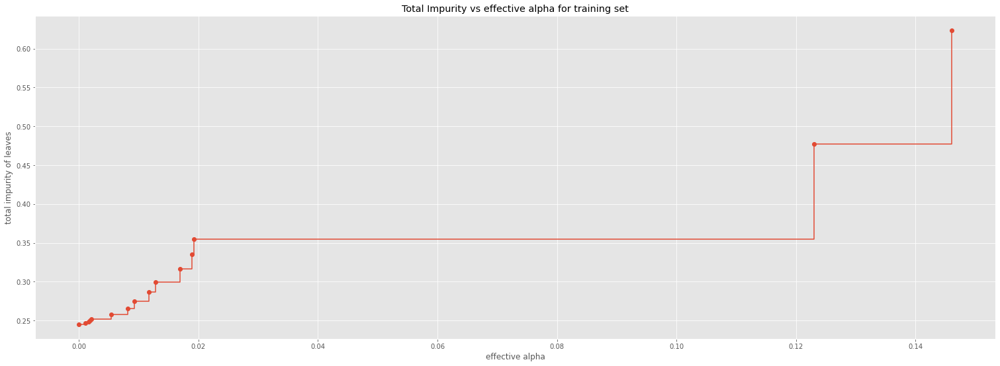

In [ ]:
fig, ax = plt.subplots(figsize=(26,9))
ax.plot(ccp_alphas[:-1], impurities[:-1], marker='o', drawstyle="steps-post")
ax.set_xlabel("effective alpha")
ax.set_ylabel("total impurity of leaves")
ax.set_title("Total Impurity vs effective alpha for training set");

In [ ]:
clfs = []
for ccp_alpha in ccp_alphas:
    clf = DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=4, max_features='sqrt', splitter='best', random_state=1, ccp_alpha=ccp_alpha)
    clf.fit(X, y)
    clfs.append(clf)
print("Number of nodes in the last tree is: {} with ccp_alpha: {}".format(
      clfs[-1].tree_.node_count, ccp_alphas[-1]))

DecisionTreeClassifier(ccp_alpha=0.0, class_weight='balanced', criterion='gini',
                       max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.0010994260244286055, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.0015636319957037397, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.0018709865220636872, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.0020871090416247663, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.005351656078295873, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.008125294348879555, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.009252913729810807, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.011742211719980147, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.012796845352895693, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.016915969028037638, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.018882261116258764, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.019262401570885934, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.12301559457126122, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.14611496673482732, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

DecisionTreeClassifier(ccp_alpha=0.1764372677057897, class_weight='balanced',
                       criterion='gini', max_depth=4, max_features='sqrt',
                       max_leaf_nodes=None, min_impurity_decrease=0.0,
                       min_impurity_split=None, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       presort='deprecated', random_state=1, splitter='best')

Number of nodes in the last tree is: 1 with ccp_alpha: 0.1764372677057897


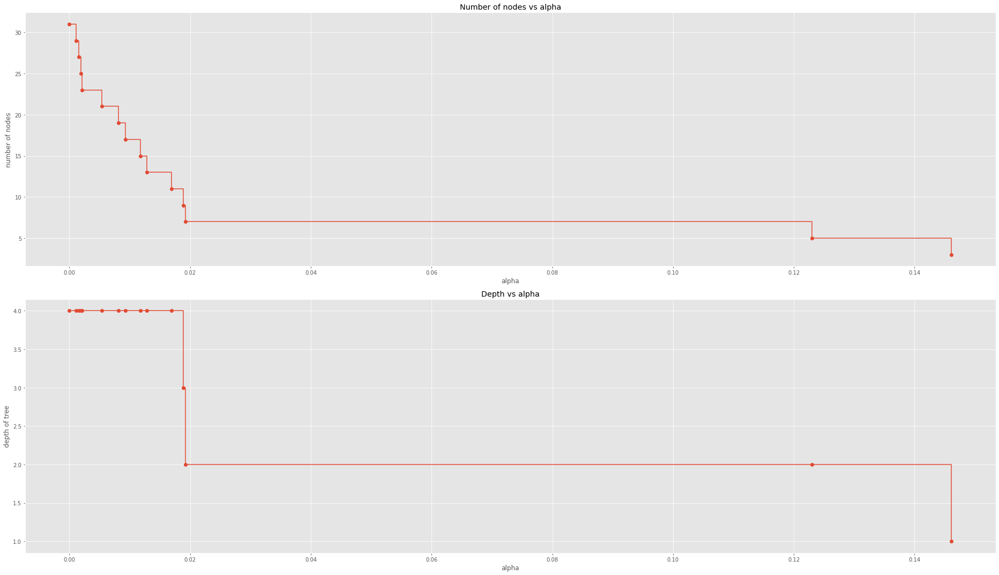

In [ ]:
clfs = clfs[:-1]
ccp_alphas = ccp_alphas[:-1]

node_counts = [clf.tree_.node_count for clf in clfs]
depth = [clf.tree_.max_depth for clf in clfs]
fig, ax = plt.subplots(2, 1, figsize=(26,15))
ax[0].plot(ccp_alphas, node_counts, marker='o', drawstyle="steps-post")
ax[0].set_xlabel("alpha")
ax[0].set_ylabel("number of nodes")
ax[0].set_title("Number of nodes vs alpha")
ax[1].plot(ccp_alphas, depth, marker='o', drawstyle="steps-post")
ax[1].set_xlabel("alpha")
ax[1].set_ylabel("depth of tree")
ax[1].set_title("Depth vs alpha")
fig.tight_layout();

### Decision Tree Classifier Pruned with best params from gridsearchCV

In [ ]:
DT_model_prun_best = DecisionTreeClassifier(class_weight='balanced', criterion='gini', max_depth=4, max_features='sqrt', splitter='best', random_state=1, ccp_alpha=0.019)

In [ ]:
DT_model_prun_best_pipeline = make_pipeline(sc, DT_model_prun_best)

In [ ]:
y_pred_DT_prun_best = cross_val_predict(DT_model_prun_best_pipeline, X, y, cv=StratifiedKFold(20, shuffle=True, random_state=1), n_jobs = -1, verbose=1)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done   4 out of  20 | elapsed:    1.5s remaining:    5.9s
[Parallel(n_jobs=-1)]: Done  20 out of  20 | elapsed:    1.7s finished


In [ ]:
DT_model_prun_best_fit = DT_model_prun_best_pipeline.fit(X,y)

In [ ]:
y_pred_DT_prun_best = le.inverse_transform(y_pred_DT_prun_best)

In [ ]:
DT_score = accuracy_score(y_lab, y_pred_DT_prun_best)

### DT Pruned Tree Visualization

In [ ]:
export_graphviz(DT_model_prun_best_pipeline.named_steps.decisiontreeclassifier, out_file='tree.dot',
                            feature_names=X.columns.tolist(),
                            class_names=labels,
                            filled=True, rounded=True,
                            special_characters=True)

In [ ]:
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=950'])
Image(filename = 'tree.png')

0

### DT Pruned Tree Rules Visualization

In [ ]:
rules = export_text(DT_model_prun_best_pipeline.named_steps.decisiontreeclassifier, feature_names=X.columns.tolist(), show_weights=True)

In [ ]:
print(rules)

|--- acc_rf_y_mad <= 0.10
|   |--- gyro_rf_y_median_absolute_deviation_logabs <= 0.08
|   |   |--- long_gyro_mean <= -0.73
|   |   |   |--- weights: [10.58, 12.98, 1229.55, 365.09, 15.65] class: 2
|   |   |--- long_gyro_mean >  -0.73
|   |   |   |--- weights: [317.26, 6.49, 1895.89, 2759.05, 69.76] class: 3
|   |--- gyro_rf_y_median_absolute_deviation_logabs >  0.08
|   |   |--- weights: [2802.46, 32.46, 74.37, 60.72, 259.36] class: 0
|--- acc_rf_y_mad >  0.10
|   |--- acc_rf_x_mean <= -1.14
|   |   |--- weights: [7.05, 2915.13, 0.00, 2.28, 316.14] class: 1
|   |--- acc_rf_x_mean >  -1.14
|   |   |--- weights: [63.45, 233.73, 0.99, 13.66, 2539.89] class: 4



### DT Confusion matrix

In [ ]:
print(classification_report(y_lab, y_pred_DT_prun_best))

              precision    recall  f1-score   support

   Bicycling       0.50      0.87      0.63       908
     Running       0.39      0.90      0.54       493
     Sitting       0.70      0.46      0.55      3228
    Standing       0.65      0.84      0.73      4217
     Walking       0.99      0.79      0.88      7158

    accuracy                           0.74     16004
   macro avg       0.64      0.77      0.67     16004
weighted avg       0.79      0.74      0.75     16004



Normalized confusion matrix


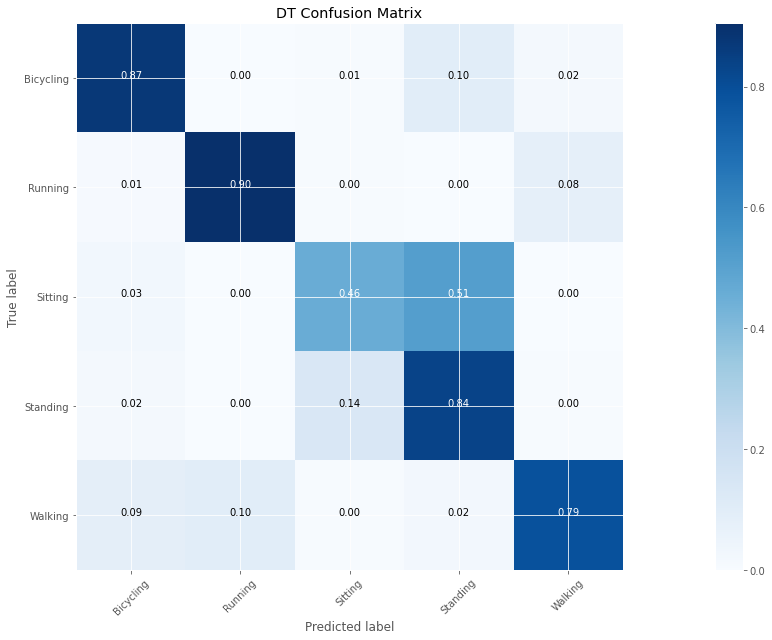

In [ ]:
cm = confusion_matrix(y_lab, y_pred_DT_prun_best)
plot_confusion_matrix(cm, classes=labels, title='DT Confusion Matrix')

### DT Feature importance

In [ ]:
useful_cols = list(X.columns)
feature_imp = pd.DataFrame(sorted(zip(DT_model_prun_best_pipeline.named_steps.decisiontreeclassifier.feature_importances_,useful_cols)), columns=['Value','Feature'])
plt.figure(figsize=(26,900))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False))
plt.title('DT Most Important Features')
plt.tight_layout()
plt.show();

### DT Learning curve

In [ ]:
# Create CV training and test scores for various training set sizes
train_sizes, train_scores, test_scores = learning_curve(DT_model_prun_best_pipeline.named_steps.decisiontreeclassifier, 
                                                        X, 
                                                        y,
                                                        # Number of folds in cross-validation
                                                        cv=StratifiedKFold(5, shuffle=True, random_state=1),
                                                        # Evaluation metric
                                                        scoring='f1_weighted',
                                                        # Use all computer cores
                                                        n_jobs=-1,
                                                        random_state=1,
                                                        shuffle=True)

In [ ]:
# Create means and standard deviations of training set scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)

# Create means and standard deviations of test set scores
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

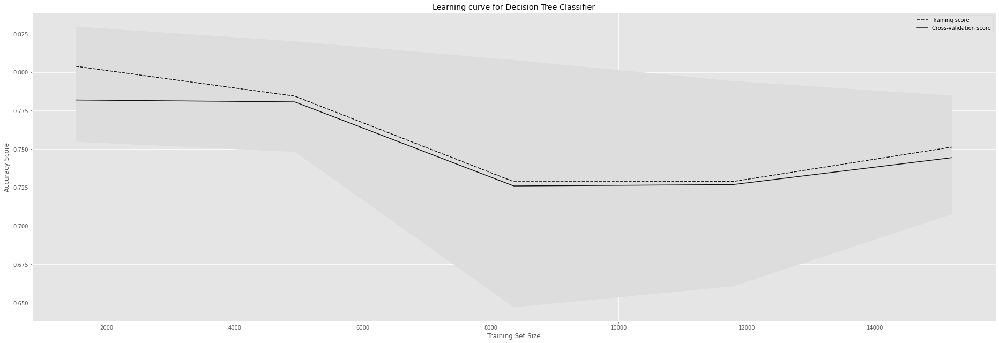

In [ ]:
# Draw lines
plt.figure(figsize=(26,9))
plt.plot(train_sizes, train_mean, '--', color="#111111",  label="Training score")
plt.plot(train_sizes, test_mean, color="#111111", label="Cross-validation score")

# Draw bands
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color="#DDDDDD")
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color="#DDDDDD")

# Create plot
plt.title("Learning curve for Decision Tree Classifier")
plt.xlabel("Training Set Size"), plt.ylabel("Accuracy Score"), plt.legend(loc="best")
plt.tight_layout()
plt.show();

## Support Vector Classifier

### Support vector classifier with gridsearchCV

In [ ]:
svc_model_grid = SVC(class_weight='balanced', random_state=1)

In [ ]:
svc_model_grid_pipeline = make_pipeline(sc, svc_model_grid)
svc_model_grid_pipeline

Pipeline(memory=None,
         steps=[('standardscaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('svc',
                 SVC(C=1.0, break_ties=False, cache_size=200,
                     class_weight='balanced', coef0=0.0,
                     decision_function_shape='ovr', degree=3, gamma='scale',
                     kernel='rbf', max_iter=-1, probability=False,
                     random_state=1, shrinking=True, tol=0.001,
                     verbose=False))],
         verbose=False)

In [ ]:
C = [0.001, 0.01, 0.1, 1.0, 2, 4, 8, 16, 10.0, 100.0, 1000.0]
kernel = ['rbf']
decision_function_shape = ['ovo']

In [ ]:
param_grid = dict(svc__C=C, svc__kernel=kernel, svc__decision_function_shape=decision_function_shape)

In [ ]:
svc_grid = GridSearchCV(estimator = svc_model_grid_pipeline, param_grid = param_grid , cv=StratifiedKFold(5, shuffle=True, random_state=1), scoring = 'f1_weighted', verbose = 1, n_jobs = -1)

In [ ]:
 svc_grid_fit = svc_grid.fit(X,y)

Fitting 5 folds for each of 11 candidates, totalling 55 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done  32 out of  55 | elapsed:  4.0min remaining:  2.9min
[Parallel(n_jobs=-1)]: Done  55 out of  55 | elapsed: 10.1min finished


In [ ]:
print("Best parameter (CV score=%0.3f):" % svc_grid_fit.best_score_)
print(svc_grid_fit.best_params_)

Best parameter (CV score=0.929):
{'svc__C': 16, 'svc__decision_function_shape': 'ovo', 'svc__kernel': 'rbf'}


### Support vector classifier with best params from gridsearchCV

In [ ]:
svc_model_best = SVC(class_weight='balanced', C=16, decision_function_shape='ovo', kernel='rbf', random_state=1)

In [ ]:
svc_model_best_pipeline = make_pipeline(sc, svc_model_best)

In [ ]:
y_pred_svc_best = cross_val_predict(svc_model_best_pipeline, X, y, cv=StratifiedKFold(5, shuffle=True, random_state=1), n_jobs = -1, verbose=1)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  1.1min finished


In [ ]:
svc_model_best_fit = svc_model_best_pipeline.fit(X,y)

In [ ]:
y_pred_svc_best = le.inverse_transform(y_pred_svc_best)

In [ ]:
SVC_score = accuracy_score(y_lab, y_pred_svc_best)

### SVC Confusion matrix

In [ ]:
print(classification_report(y_lab, y_pred_svc_best))

              precision    recall  f1-score   support

   Bicycling       0.99      0.96      0.98       908
     Running       0.97      0.90      0.93       493
     Sitting       0.85      0.86      0.86      3228
    Standing       0.88      0.87      0.88      4217
     Walking       0.98      0.99      0.99      7158

    accuracy                           0.93     16004
   macro avg       0.94      0.92      0.93     16004
weighted avg       0.93      0.93      0.93     16004



Normalized confusion matrix


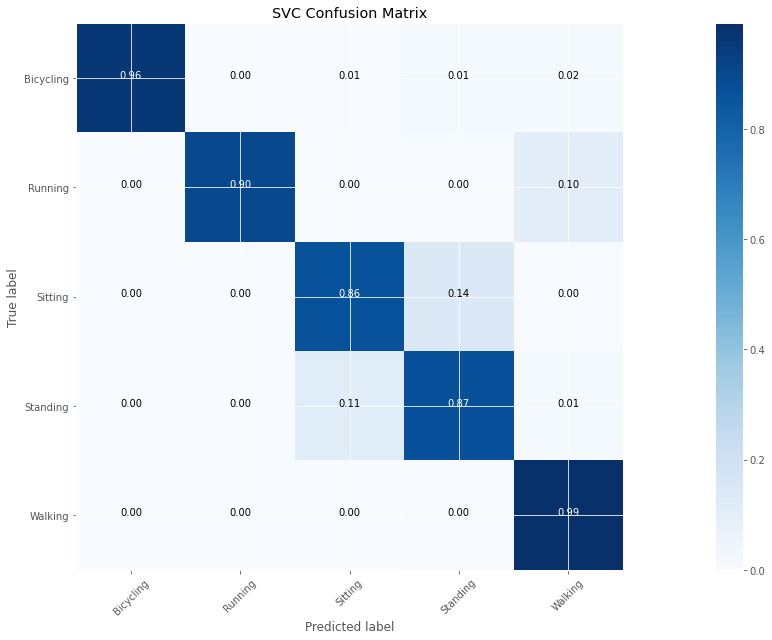

In [ ]:
cm = confusion_matrix(y_lab, y_pred_svc_best)
plot_confusion_matrix(cm, classes=labels, title='SVC Confusion Matrix')

### SVC Learning curve

In [ ]:
# Create CV training and test scores for various training set sizes
train_sizes, train_scores, test_scores = learning_curve(svc_model_best_fit.named_steps.svc, 
                                                        X, 
                                                        y,
                                                        # Number of folds in cross-validation
                                                        cv=StratifiedKFold(5, shuffle=True, random_state=1),
                                                        # Evaluation metric
                                                        scoring='f1_weighted',
                                                        # Use all computer cores
                                                        n_jobs=-1,
                                                        random_state=1,
                                                        shuffle=True)

In [ ]:
# Create means and standard deviations of training set scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)

# Create means and standard deviations of test set scores
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

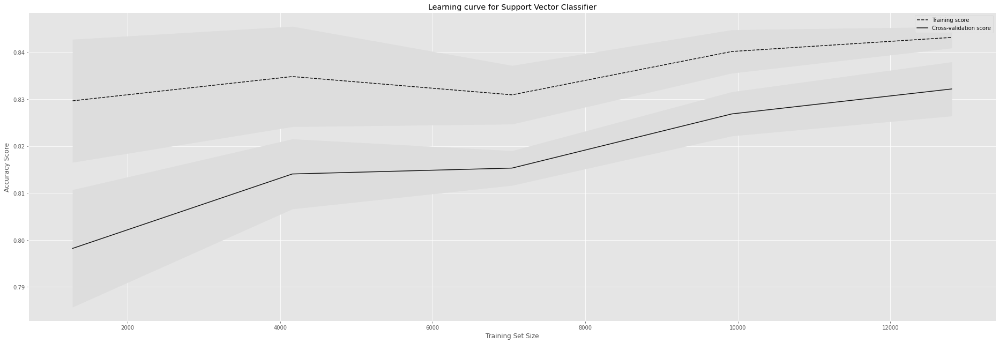

In [ ]:
# Draw lines
plt.figure(figsize=(26,9))
plt.plot(train_sizes, train_mean, '--', color="#111111",  label="Training score")
plt.plot(train_sizes, test_mean, color="#111111", label="Cross-validation score")

# Draw bands
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color="#DDDDDD")
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color="#DDDDDD")

# Create plot
plt.title("Learning curve for Support Vector Classifier")
plt.xlabel("Training Set Size"), plt.ylabel("Accuracy Score"), plt.legend(loc="best")
plt.tight_layout()
plt.show();

## KNN Classifier

### KNN Classifier with gridsearchCV

In [ ]:
KNN_model = KNeighborsClassifier(n_jobs = -1)

In [ ]:
KNN_model_pipeline = make_pipeline(sc, KNN_model)

In [ ]:
n_neighbors = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10]
weights = ['uniform', 'distance']
p = [1, 2]

In [ ]:
param_grid = dict(kneighborsclassifier__n_neighbors=n_neighbors, kneighborsclassifier__weights=weights, kneighborsclassifier__p=p)

In [ ]:
KNN_grid = GridSearchCV(estimator = KNN_model_pipeline, param_grid = param_grid , cv=StratifiedKFold(5, shuffle=True, random_state=1), scoring = 'f1_weighted', verbose = 1)

In [ ]:
KNN_grid_fit = KNN_grid.fit(X,y)

Fitting 5 folds for each of 40 candidates, totalling 200 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 200 out of 200 | elapsed: 13.9min finished


In [ ]:
print("Best parameter (CV score=%0.3f):" % KNN_grid_fit.best_score_)
print(KNN_grid_fit.best_params_)  

Best parameter (CV score=0.924):
{'kneighborsclassifier__n_neighbors': 4, 'kneighborsclassifier__p': 1, 'kneighborsclassifier__weights': 'distance'}


### KNN classifier with best params from gridsearchCV

In [ ]:
KNN_model_best = KNeighborsClassifier(n_neighbors=4, p=1, weights='distance', n_jobs = -1)

In [ ]:
KNN_model_best_pipeline = make_pipeline(sc, KNN_model_best)

In [ ]:
y_pred_KNN_best = cross_val_predict(KNN_model_best_pipeline, X, y, cv=StratifiedKFold(5, shuffle=True, random_state=1), n_jobs = -1, verbose=1)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   16.5s finished


In [ ]:
KNN_model_best_fit = KNN_model_best_pipeline.fit(X,y)

In [ ]:
y_pred_KNN_best = le.inverse_transform(y_pred_KNN_best)

In [ ]:
KNN_score = accuracy_score(y_lab, y_pred_KNN_best)

### KNN Confusion matrix

In [ ]:
print(classification_report(y_lab, y_pred_KNN_best))

              precision    recall  f1-score   support

   Bicycling       0.99      0.98      0.98       908
     Running       0.96      0.87      0.91       493
     Sitting       0.84      0.86      0.85      3228
    Standing       0.88      0.86      0.87      4217
     Walking       0.98      0.99      0.98      7158

    accuracy                           0.92     16004
   macro avg       0.93      0.91      0.92     16004
weighted avg       0.92      0.92      0.92     16004



Normalized confusion matrix


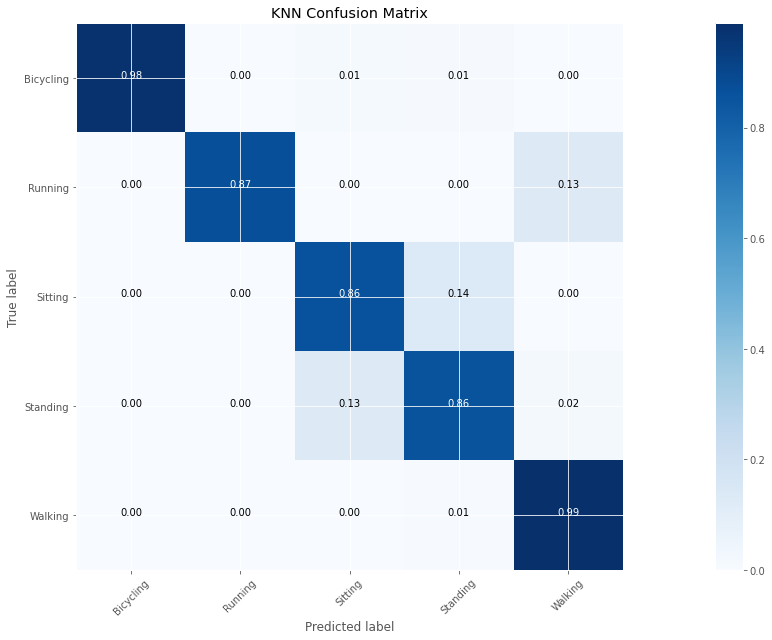

In [ ]:
cm = confusion_matrix(y_lab, y_pred_KNN_best)
plot_confusion_matrix(cm, classes=labels, title='KNN Confusion Matrix')

### KNN Learning curve

In [ ]:
# Create CV training and test scores for various training set sizes
train_sizes, train_scores, test_scores = learning_curve(KNN_model_best_fit.named_steps.kneighborsclassifier, 
                                                        X, 
                                                        y,
                                                        # Number of folds in cross-validation
                                                        cv=StratifiedKFold(5, shuffle=True, random_state=1),
                                                        # Evaluation metric
                                                        scoring='f1_weighted',
                                                        # Use all computer cores
                                                        n_jobs=-1,
                                                        random_state=1,
                                                        shuffle=True)

In [ ]:
# Create means and standard deviations of training set scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)

# Create means and standard deviations of test set scores
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

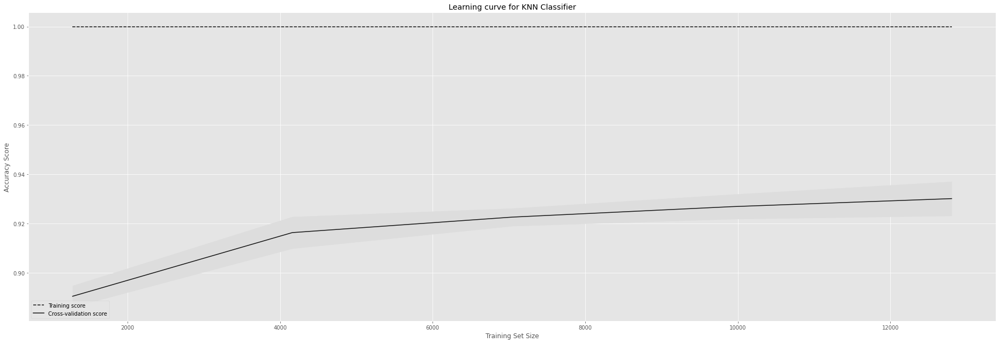

In [ ]:
# Draw lines
plt.figure(figsize=(26,9))
plt.plot(train_sizes, train_mean, '--', color="#111111",  label="Training score")
plt.plot(train_sizes, test_mean, color="#111111", label="Cross-validation score")

# Draw bands
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color="#DDDDDD")
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color="#DDDDDD")

# Create plot
plt.title("Learning curve for KNN Classifier")
plt.xlabel("Training Set Size"), plt.ylabel("Accuracy Score"), plt.legend(loc="best")
plt.tight_layout()
plt.show();

## Random Forest Classifier

### Random forest classifier with gridsearchCV

In [ ]:
RF_model = RandomForestClassifier(random_state=1, n_jobs=-1)

In [ ]:
RF_model_pipeline = make_pipeline(sc, RF_model)

In [ ]:
n_estimators = np.arange(10,101,5)
criterion = ['gini','entropy']
max_depth = np.arange(1,11)
max_features = ['sqrt','log2']
class_weight = ['balanced','balanced_subsample']

In [ ]:
param_grid = dict(randomforestclassifier__n_estimators=n_estimators, randomforestclassifier__criterion=criterion, randomforestclassifier__max_depth=max_depth, randomforestclassifier__max_features=max_features, randomforestclassifier__class_weight=class_weight)

In [ ]:
RF_grid = GridSearchCV(estimator = RF_model_pipeline, param_grid = param_grid , cv=StratifiedKFold(5, shuffle=True, random_state=1), scoring = 'f1_weighted', verbose = 1, n_jobs = -1)

In [ ]:
RF_grid_fit = RF_grid.fit(X,y)

Fitting 5 folds for each of 1520 candidates, totalling 7600 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done 120 tasks      | elapsed:   12.7s
[Parallel(n_jobs=-1)]: Done 370 tasks      | elapsed:   37.0s
[Parallel(n_jobs=-1)]: Done 720 tasks      | elapsed:  1.6min
[Parallel(n_jobs=-1)]: Done 1170 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done 1720 tasks      | elapsed:  6.1min
[Parallel(n_jobs=-1)]: Done 2370 tasks      | elapsed:  9.2min
[Parallel(n_jobs=-1)]: Done 3120 tasks      | elapsed: 15.7min
[Parallel(n_jobs=-1)]: Done 3970 tasks      | elapsed: 23.8min
[Parallel(n_jobs=-1)]: Done 4920 tasks      | elapsed: 26.8min
[Parallel(n_jobs=-1)]: Done 5970 tasks      | elapsed: 32.1min
[Parallel(n_jobs=-1)]: Done 7120 tasks      | elapsed: 42.1min
[Parallel(n_jobs=-1)]: Done 7600 out of 7600 | elapsed: 47.7min finished


In [ ]:
print("Best parameter (CV score=%0.3f):" % RF_grid_fit.best_score_)
print(RF_grid_fit.best_params_)

Best parameter (CV score=0.936):
{'randomforestclassifier__class_weight': 'balanced_subsample', 'randomforestclassifier__criterion': 'entropy', 'randomforestclassifier__max_depth': 10, 'randomforestclassifier__max_features': 'sqrt', 'randomforestclassifier__n_estimators': 95}


### Random Forest Classifier with best params from gridsearchCV

In [ ]:
RF_model_best = RandomForestClassifier(class_weight='balanced_subsample', criterion='entropy', max_depth=10, max_features='sqrt', n_estimators=95, random_state=1, n_jobs=-1)

In [ ]:
RF_model_best_pipeline = make_pipeline(sc, RF_model_best)

In [ ]:
y_pred_RF_best = cross_val_predict(RF_model_best_pipeline, X, y, cv=StratifiedKFold(5, shuffle=True, random_state=1), n_jobs = -1, verbose=1)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:   11.0s finished


In [ ]:
RF_model_best_fit = RF_model_best_pipeline.fit(X,y)

In [ ]:
y_pred_RF_best = le.inverse_transform(y_pred_RF_best)

In [ ]:
RF_score = accuracy_score(y_lab, y_pred_RF_best)

### Feature selection by importances from Random Forest gridsearchCV

In [ ]:
RF_feature_importances = RF_model_best_pipeline.named_steps.randomforestclassifier.feature_importances_
RF_feature_importances = pd.DataFrame({'feature': list(X.columns), 'importance': RF_feature_importances}).sort_values('importance', ascending = False)
RF_feature_importances

,feature,importance
20,acc_rf_y_mad,0.0291
15,acc_rf_y_std,0.0289
464,acc_norm_mean_logabs,0.0246
498,gyro_norm_median_logabs,0.0234
497,gyro_norm_mean_logabs,0.0231
...,...,...
299,colat_acc_kurtosis_lag2,0.0000
649,gyro_rf_z_skew_lag2_logabs,0.0000
757,colat_gyro_std_lag2_logabs,0.0000
651,gyro_rf_z_kurtosis_lag2_logabs,0.0000


In [ ]:
# Find the features with zero importance
RF_zero_features = list(RF_feature_importances[RF_feature_importances['importance'] == 0.0]['feature'])
print('There are %d features with 0.0 importance' % len(RF_zero_features))
RF_feature_importances.tail()

There are 0 features with 0.0 importance


,feature,importance
299,colat_acc_kurtosis_lag2,0.0000
649,gyro_rf_z_skew_lag2_logabs,0.0000
757,colat_gyro_std_lag2_logabs,0.0000
651,gyro_rf_z_kurtosis_lag2_logabs,0.0000
353,colat_gyro_amin_lag2,0.0000


### RF Confusion matrix

In [ ]:
print(classification_report(y_lab, y_pred_RF_best))

              precision    recall  f1-score   support

   Bicycling       1.00      1.00      1.00       908
     Running       0.98      0.90      0.94       493
     Sitting       0.91      0.81      0.86      3228
    Standing       0.86      0.93      0.89      4217
     Walking       0.98      0.99      0.99      7158

    accuracy                           0.94     16004
   macro avg       0.95      0.93      0.94     16004
weighted avg       0.94      0.94      0.94     16004



Normalized confusion matrix


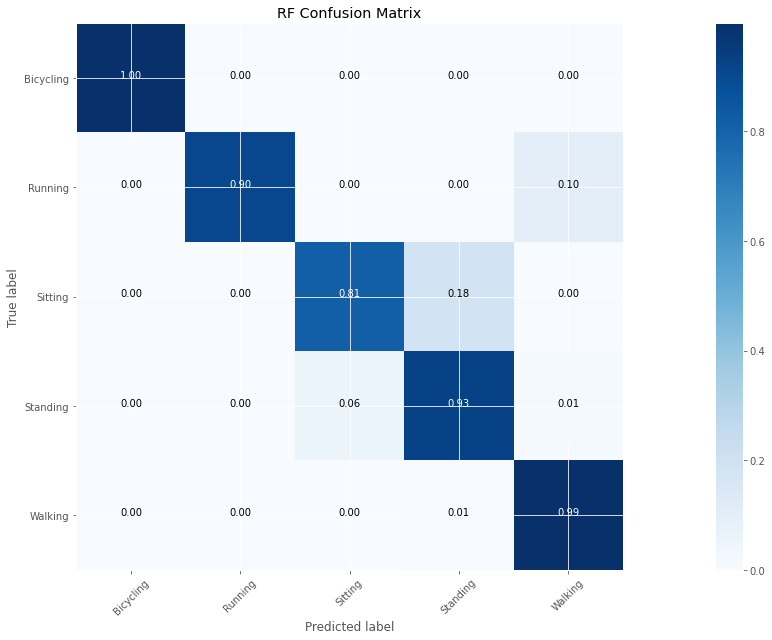

In [ ]:
cm = confusion_matrix(y_lab, y_pred_RF_best)
plot_confusion_matrix(cm, classes=labels, title='RF Confusion Matrix')

### RF Feature importance

In [ ]:
useful_cols = list(X.columns)
feature_imp = pd.DataFrame(sorted(zip(RF_model_best_pipeline.named_steps.randomforestclassifier.feature_importances_,useful_cols)), columns=['Value','Feature'])
plt.figure(figsize=(26,900))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False))
plt.title('RF Most Important Features')
plt.tight_layout()
plt.show();

### RF Learning curve

In [ ]:
# Create CV training and test scores for various training set sizes
train_sizes, train_scores, test_scores = learning_curve(RF_model_best_pipeline.named_steps.randomforestclassifier, 
                                                        X, 
                                                        y,
                                                        # Number of folds in cross-validation
                                                        cv=StratifiedKFold(5, shuffle=True, random_state=1),
                                                        # Evaluation metric
                                                        scoring='f1_weighted',
                                                        # Use all computer cores
                                                        n_jobs=-1,
                                                        random_state=1,
                                                        shuffle=True)

In [ ]:
# Create means and standard deviations of training set scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)

# Create means and standard deviations of test set scores
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

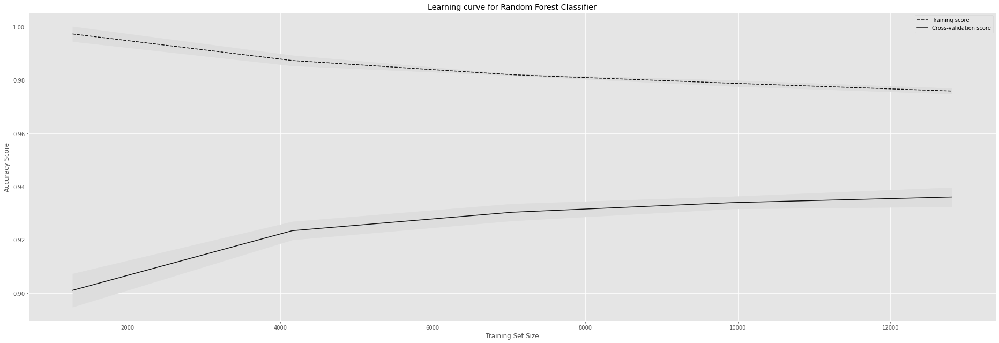

In [ ]:
# Draw lines
plt.figure(figsize=(26,9))
plt.plot(train_sizes, train_mean, '--', color="#111111",  label="Training score")
plt.plot(train_sizes, test_mean, color="#111111", label="Cross-validation score")

# Draw bands
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color="#DDDDDD")
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color="#DDDDDD")

# Create plot
plt.title("Learning curve for Random Forest Classifier")
plt.xlabel("Training Set Size"), plt.ylabel("Accuracy Score"), plt.legend(loc="best")
plt.tight_layout()
plt.show();

## XGBoost Classifier

### XGBoost Classifier with gridsearchCV

In [ ]:
XGBoost_model = XGBClassifier(random_state=1, n_jobs=-1)  

In [ ]:
XGBoost_model_pipeline = make_pipeline(sc, XGBoost_model)

In [ ]:
XGBoost_model_pipeline

Pipeline(memory=None,
         steps=[('standardscaler',
                 StandardScaler(copy=True, with_mean=True, with_std=True)),
                ('xgbclassifier',
                 XGBClassifier(base_score=0.5, booster='gbtree',
                               colsample_bylevel=1, colsample_bynode=1,
                               colsample_bytree=1, gamma=0, learning_rate=0.1,
                               max_delta_step=0, max_depth=3,
                               min_child_weight=1, missing=None,
                               n_estimators=100, n_jobs=-1, nthread=None,
                               objective='binary:logistic', random_state=1,
                               reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
                               seed=None, silent=None, subsample=1,
                               verbosity=1))],
         verbose=False)

In [ ]:
max_depth = np.arange(10,16)

In [ ]:
param_grid = dict(xgbclassifier__max_depth=max_depth)

In [ ]:
XGBoost_grid = GridSearchCV(estimator = XGBoost_model_pipeline, param_grid = param_grid , cv=StratifiedKFold(5, shuffle=True, random_state=1), scoring = 'f1_weighted', verbose = 1, n_jobs = -1)

In [ ]:
XGBoost_grid_fit = XGBoost_grid.fit(X,y)

Fitting 5 folds for each of 6 candidates, totalling 30 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done  13 out of  30 | elapsed: 15.1min remaining: 19.8min
[Parallel(n_jobs=-1)]: Done  30 out of  30 | elapsed: 17.1min finished


In [ ]:
print("Best parameter (CV score=%0.3f):" % XGBoost_grid_fit.best_score_)
print(XGBoost_grid_fit.best_params_)

Best parameter (CV score=0.958):
{'xgbclassifier__max_depth': 11}


### XGBoost Classifier with best params from gridsearchCV

In [ ]:
XGBoost_model_best = XGBClassifier(max_depth=11, random_state=1, n_jobs=-1)  

In [ ]:
XGBoost_model_best_pipeline = make_pipeline(sc, XGBoost_model_best)

In [ ]:
y_pred_XGBoost_best = cross_val_predict(XGBoost_model_best_pipeline, X, y, cv=StratifiedKFold(5, shuffle=True, random_state=1), n_jobs = -1, verbose=1)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 40 concurrent workers.
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed: 10.7min finished


In [ ]:
XGBoost_model_best_fit = XGBoost_model_best_pipeline.fit(X,y)

In [ ]:
y_pred_XGBoost_best = le.inverse_transform(y_pred_XGBoost_best)

In [ ]:
XGBoost_score = accuracy_score(y_lab, y_pred_XGBoost_best)

### Feature selection by importances from XGBoost gridsearchCV

In [ ]:
XGBoost_feature_importances = XGBoost_model_best_pipeline.named_steps.xgbclassifier.feature_importances_
XGBoost_feature_importances = pd.DataFrame({'feature': list(X.columns), 'importance': XGBoost_feature_importances}).sort_values('importance', ascending = False)
XGBoost_feature_importances

,feature,importance
396,acc_rf_x_amin_logabs,0.3062
15,acc_rf_y_std,0.0720
19,acc_rf_y_median_absolute_deviation,0.0447
132,acc_rf_x_amin_lag1,0.0376
68,acc_norm_mean,0.0264
...,...,...
570,acc_rf_y_ran_lag1_logabs,0.0000
571,acc_rf_y_ran_lag2_logabs,0.0000
580,acc_rf_z_std_lag1_logabs,0.0000
581,acc_rf_z_std_lag2_logabs,0.0000


In [ ]:
# Find the features with zero importance
XGBoost_zero_features = list(XGBoost_feature_importances[XGBoost_feature_importances['importance'] == 0.0]['feature'])
print('There are %d features with 0.0 importance' % len(XGBoost_zero_features))
XGBoost_feature_importances.tail()

There are 227 features with 0.0 importance


,feature,importance
570,acc_rf_y_ran_lag1_logabs,0.0000
571,acc_rf_y_ran_lag2_logabs,0.0000
580,acc_rf_z_std_lag1_logabs,0.0000
581,acc_rf_z_std_lag2_logabs,0.0000
791,long_gyro_ran_lag2_logabs,0.0000


### XGBoost Confusion matrix

In [ ]:
print(classification_report(y_lab, y_pred_XGBoost_best))

              precision    recall  f1-score   support

   Bicycling       1.00      1.00      1.00       908
     Running       0.98      0.94      0.96       493
     Sitting       0.94      0.89      0.92      3228
    Standing       0.91      0.94      0.93      4217
     Walking       0.99      0.99      0.99      7158

    accuracy                           0.96     16004
   macro avg       0.96      0.95      0.96     16004
weighted avg       0.96      0.96      0.96     16004



Normalized confusion matrix


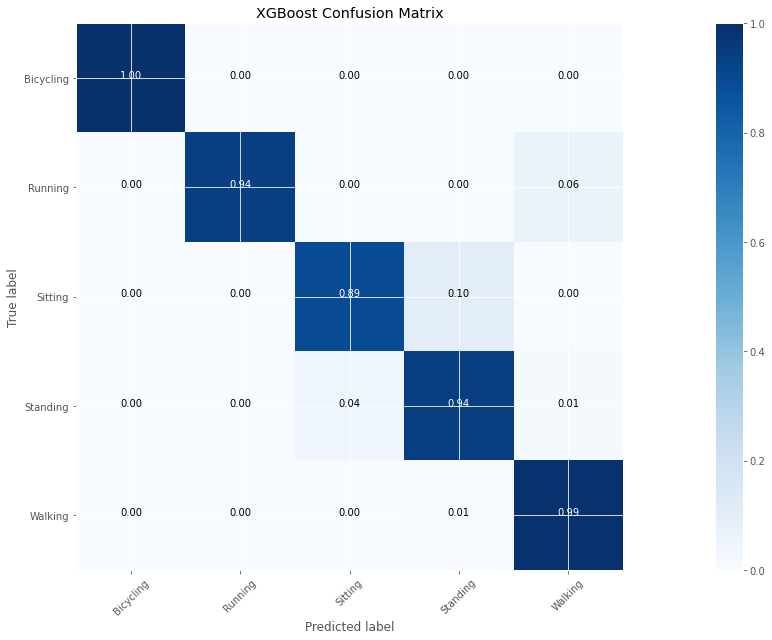

In [ ]:
cm = confusion_matrix(y_lab, y_pred_XGBoost_best)
plot_confusion_matrix(cm, classes=labels, title='XGBoost Confusion Matrix')

### XGBoost Feature importance

In [ ]:
useful_cols = list(X.columns)
feature_imp = pd.DataFrame(sorted(zip(XGBoost_model_best_pipeline.named_steps.xgbclassifier.feature_importances_,useful_cols)), columns=['Value','Feature'])
plt.figure(figsize=(26,900))
sns.barplot(x="Value", y="Feature", data=feature_imp.sort_values(by="Value", ascending=False))
plt.title('XGBoost Most Important Features')
plt.tight_layout()
plt.show();

### XGBoost Learning curve

In [ ]:
# Create CV training and test scores for various training set sizes
train_sizes, train_scores, test_scores = learning_curve(XGBoost_model_best_pipeline.named_steps.xgbclassifier, 
                                                        X, 
                                                        y,
                                                        # Number of folds in cross-validation
                                                        cv=StratifiedKFold(5, shuffle=True, random_state=1),
                                                        # Evaluation metric
                                                        scoring='f1_weighted',
                                                        # Use all computer cores
                                                        n_jobs=-1,
                                                        random_state=1,
                                                        shuffle=True)

In [ ]:
# Create means and standard deviations of training set scores
train_mean = np.mean(train_scores, axis=1)
train_std = np.std(train_scores, axis=1)

# Create means and standard deviations of test set scores
test_mean = np.mean(test_scores, axis=1)
test_std = np.std(test_scores, axis=1)

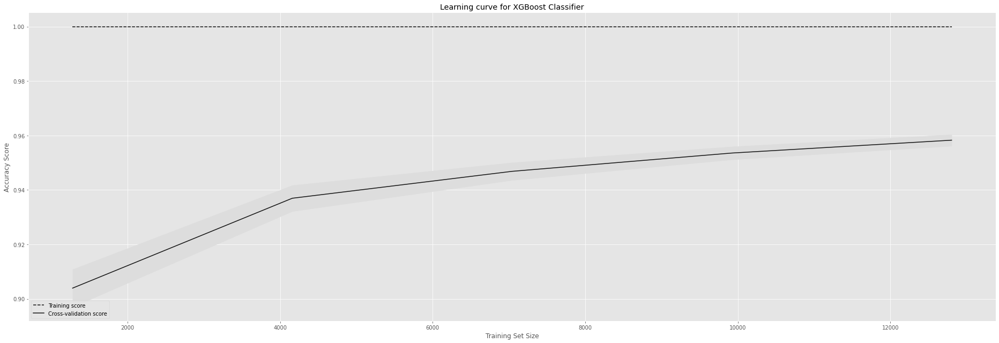

In [ ]:
# Draw lines
plt.figure(figsize=(26,9))
plt.plot(train_sizes, train_mean, '--', color="#111111",  label="Training score")
plt.plot(train_sizes, test_mean, color="#111111", label="Cross-validation score")

# Draw bands
plt.fill_between(train_sizes, train_mean - train_std, train_mean + train_std, color="#DDDDDD")
plt.fill_between(train_sizes, test_mean - test_std, test_mean + test_std, color="#DDDDDD")

# Create plot
plt.title("Learning curve for XGBoost Classifier")
plt.xlabel("Training Set Size"), plt.ylabel("Accuracy Score"), plt.legend(loc="best")
plt.tight_layout()
plt.show();

## ML Models Accuracy Validation Comparison

In [ ]:
ML_score_series = pd.Series([LR_score, DT_score, SVC_score, KNN_score, RF_score, XGBoost_score],
                            ['LR_score','DT_score','SVM_score','KNN_score','RF_score', 'XGBoost_score'])

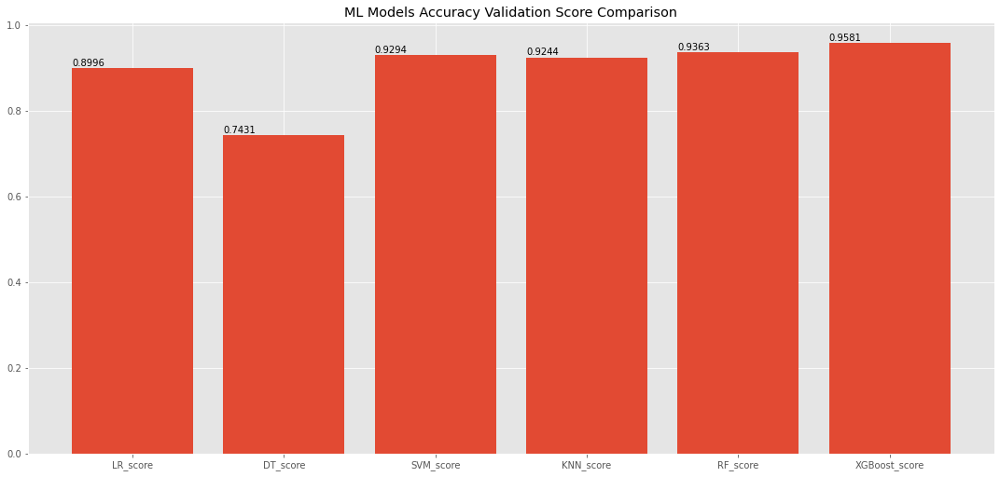

In [ ]:
# Comparison of different model accuracy scores
plt.figure(figsize=(15, 7))
bars = plt.bar(ML_score_series.index, ML_score_series.values)
for bar in bars:
    yval = round(bar.get_height(),4)
    plt.text(bar.get_x(), yval + .005, yval)
plt.tight_layout()
plt.title('ML Models Accuracy Validation Score Comparison')
plt.show();